## Add path to source files

In [1]:
import sys, os
sys.path.insert(0, os.path.join(os.path.abspath('..'), 'src'))

## If not already created, create folder for saving figures

In [2]:
save_folder = r'example-configuration-flow-test-cont'
if not os.path.isdir(save_folder):
    os.makedirs(save_folder)

## Import necessary packages, make plots big

In [3]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

import FiniteDifference as fd
import LiquidCrystalHelper as lch
import biharm as bh

import time
from importlib import reload

In [4]:
import ipywidgets as widgets
from IPython.display import display
from IPython.display import Video
from IPython.display import Image

In [5]:
reload(lch)

<module 'LiquidCrystalHelper' from 'C:\\Users\\lucas\\Documents\\Grad Work\\Summer Research 2020\\LiquidCrystalHydrodynamics\\src\\LiquidCrystalHelper.py'>

In [6]:
%matplotlib inline
dpi = 700
mpl.rcParams['figure.dpi'] = dpi

## Set up domain

In [7]:
lx = 70
ly = 70
nx = 257
ny = 257

def setUpDomain(lx=70, ly=70, nx=257, ny=257):
    
    x = np.linspace(0, lx, num=nx)
    y = np.linspace(0, ly, num=ny)
    X, Y = np.meshgrid(x, y, indexing='ij')
    dx = x[1] - x[0]
    dy = y[1] - y[0]
    
    return X, Y, dx, dy

X, Y, dx, dy = setUpDomain()

## Set up example configuration:
$S = \text{const.}, \hat{n} = \left( \epsilon \cos x, 0, 1 \right)$

In [8]:
epsilon = 0.1
S = 0.5

def setQConfig(X, Y, lx=70, ly=70, nx=257, n_y=257, n_periods=10, epsilon=0.1, S=0.5):
    
    n_hat = np.zeros((3,) + np.shape(X))

    k_x = n_periods*np.pi/lx

    n_hat[0] = epsilon*np.cos(k_x*X)
    n_hat[1] = 1

    Q = np.zeros((3, 3) + np.shape(X))
    I = np.eye(nx, ny)

    for i in range(3):
        for j in range(3):
            Q[i, j] = (S/2)*(3*n_hat[i]*n_hat[j] - I[i, j])
            
    return Q

Q = setQConfig(X, Y)

## Calculate auxiliary variables

In [9]:
eta, mu, nu = lch.auxVars(Q)

## Plot the configuration

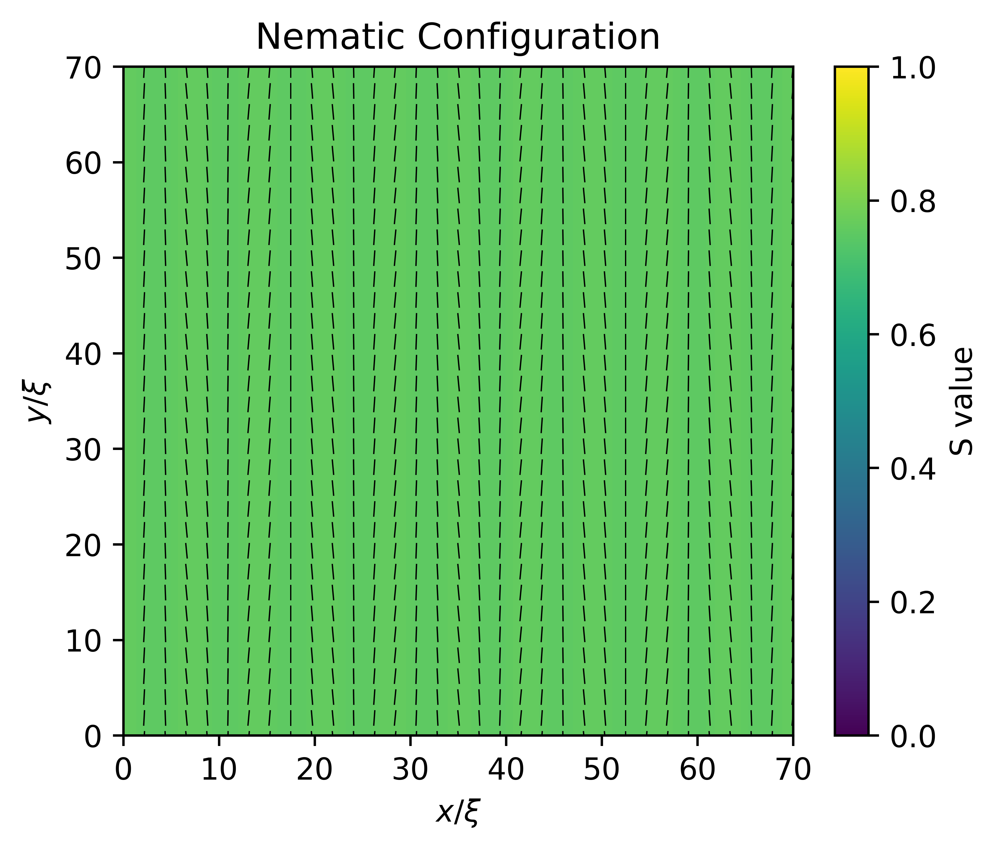

In [10]:
sparse_shape = (30, 30)
S_sparse_shape = (257, 257)
S_cutoff = 0.3

filename_nematic = os.path.join(save_folder, r'nematic-configuration.png')

def plotNematicConfig(eta, mu, nu, filename, sparse_shape=(30, 30), 
                      S_sparse_shape=(257, 257), S_cutoff=0.3):

    lambda_max = lch.calcQEigenvals(eta, mu, nu)
    U, V = lch.calcQEigenvecs(eta, mu, nu, lambda_max, S_cutoff)

    sparse_idx = lch.sparseIdx(Q[0, 0].shape, sparse_shape)
    S_sparse_idx = lch.sparseIdx(Q[0, 0].shape, S_sparse_shape)

    fig, ax = plt.subplots(figsize=(5, 4.1))
    c = ax.pcolor(X[S_sparse_idx], Y[S_sparse_idx],  (3/2)*lambda_max[S_sparse_idx], vmin=0, vmax=1)
    q = ax.quiver(X[sparse_idx], Y[sparse_idx], U[sparse_idx], V[sparse_idx],
                  headwidth=0, pivot='middle', headaxislength=5, scale=30, width=0.002)

    ax.axis('equal')
    fig.colorbar(c, ax=ax, label="S value")
    ax.set_title("Nematic Configuration")
    ax.set_xlabel(r"$x/\xi$")
    ax.set_ylabel(r"$y/\xi$")

    fig.savefig(filename)
    
    return fig, ax, c, q
    
fig, ax, c, q = plotNematicConfig(eta, mu, nu, filename_nematic)

## Set up biharmonic solver

In [11]:
def setUpBHSolver(lx, ly, nx, ny):
    L = [lx, ly]
    shape = [nx - 1, ny - 1]
    alpha = 0
    maxiter = 500

    bh_solver = bh.Biharm(L, shape, alpha, cg_maxiter=maxiter)
    
    return bh_solver

bh_solver = setUpBHSolver(lx, ly, nx, ny)

## Actually solve the biharmonic equation

In [12]:
def bhSourceTerm(eta, mu, nu, 
                 dx, dy, a=lch.a, b=lch.b):
    return (1 / (b - (1/4)*a**2)) * ( 2*lch.f1(eta, mu, nu, dx, dy) )

source_term = bhSourceTerm(eta, mu, nu, dx, dy)
psi = np.zeros(eta.shape)
psi[1:-1, 1:-1], info, calls = bh_solver.solve(source_term[1:-1, 1:-1])

In [13]:
def bhSourceTerm(eta, mu, nu, 
                 dx, dy, a=lch.a, b=lch.b):
    return (1 / (b - (1/4)*a**2)) * ( 2*lch.f1(eta, mu, nu, dx, dy) 
                                      + (1/2)*a*lch.f2(eta, mu, nu, dx, dy) )

source_term = bhSourceTerm(eta, mu, nu, dx, dy)
psi = np.zeros(eta.shape)
psi[1:-1, 1:-1], info, calls = bh_solver.solve(source_term[1:-1, 1:-1])

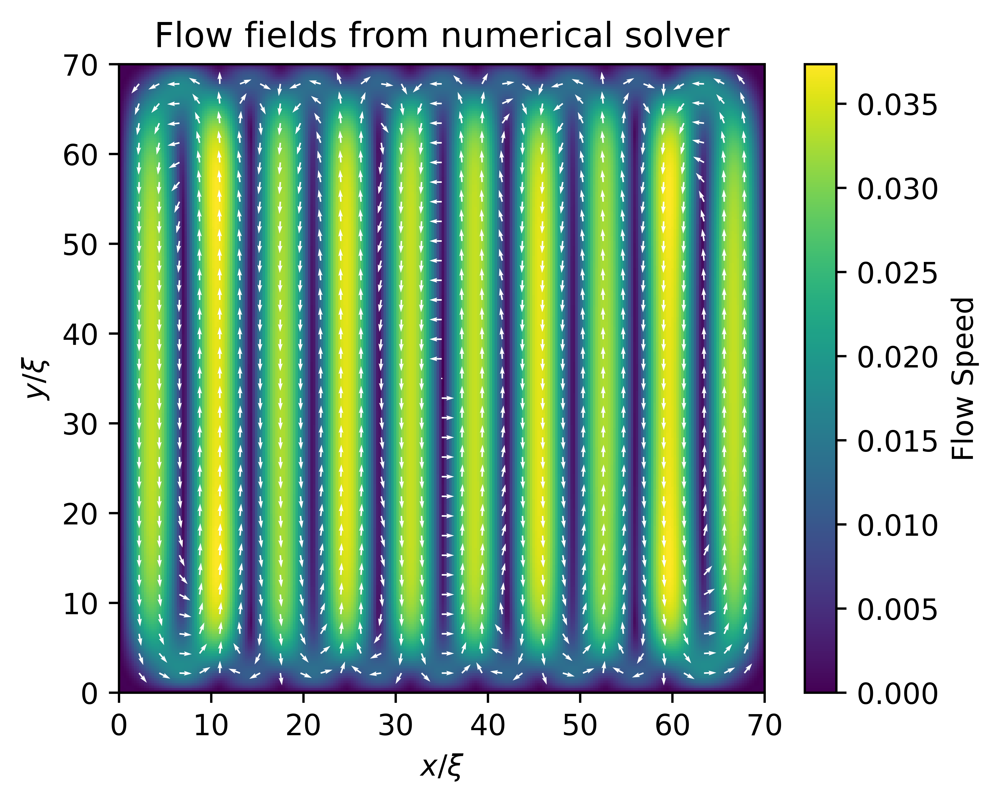

In [19]:
vx, vy = fd.curl(psi, dx, dy)
v = np.sqrt(vx**2 + vy**2)

title = 'Flow fields from numerical solver'
filename_numeric_flow = filename_stress_tensor = os.path.join(save_folder, r'flow-field-numerical-10-periods.png')

def plotFlowField(X, Y, vx, vy, v, title, filename):

    mask = np.where(v != 0)
    vx_norm = np.zeros(vx.shape)
    vy_norm = np.zeros(vy.shape)
    vx_norm[mask] = vx[mask]/v[mask]
    vy_norm[mask] = vy[mask]/v[mask]

    sparse_idx = lch.sparseIdx(vx.shape, (30, 30))

    fig, ax = plt.subplots(figsize=(5, 4))
    c = ax.pcolor(X, Y, v)
    fig.colorbar(c, ax=ax, label="Flow Speed")
    q = ax.quiver(X[sparse_idx], Y[sparse_idx],
                  vx_norm[sparse_idx], vy_norm[sparse_idx], pivot='tail', color='w')
    ax.set_title(title)
    ax.set_xlabel(r'$x/\xi$')
    ax.set_ylabel(r'$y/\xi$')

    fig.savefig(filename)
    
    return fig, ax, c, q

fig, ax, c, q = plotFlowField(X, Y, vx, vy, v, 
                              title, filename_numeric_flow)

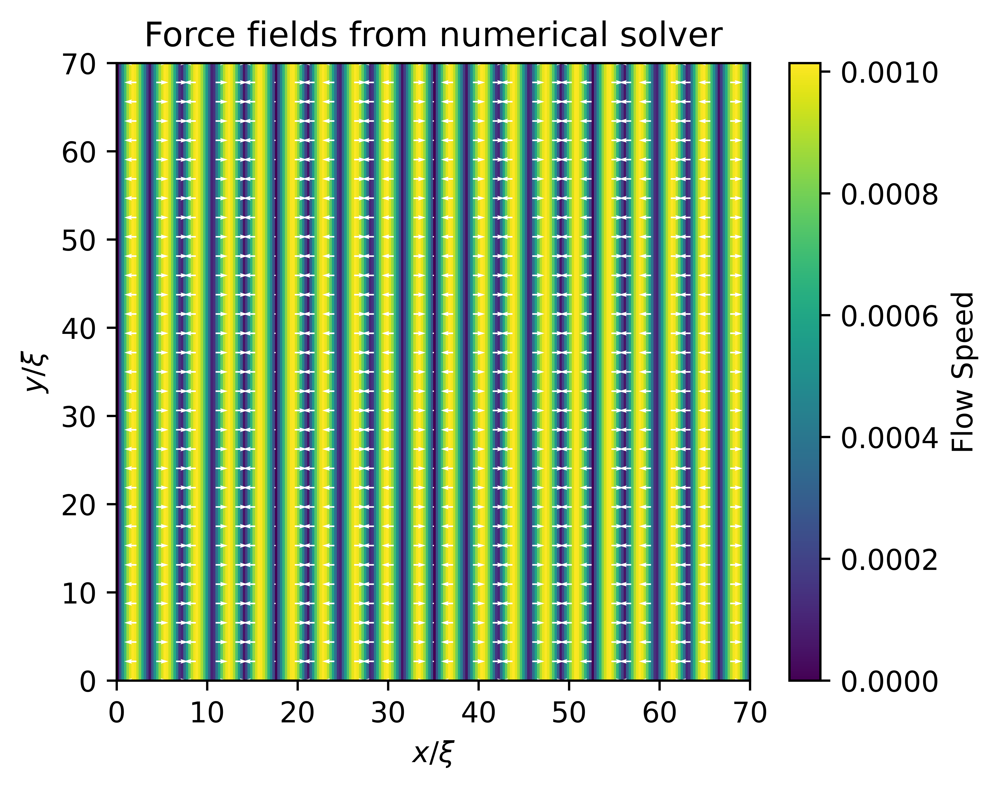

In [20]:
fx, fy = lch.fe_iso(eta, mu, nu, dx, dy=None)

f = np.sqrt(fx**2 + fy**2)

title = 'Force fields from numerical solver'
filename_numeric_flow = filename_stress_tensor = os.path.join(save_folder, r'force-field-numerical-10-periods.png')

fig, ax, c, q = plotFlowField(X, Y, fx, fy, f, 
                              title, filename_numeric_flow)

## Plot analytic solution

In [147]:
def analyticVelocityCoeff(k_x, S, epsilon, a=lch.a, b=lch.b):
    alpha = 1/(b - (1/4)*a**2)
    return ( -3*alpha*a*S/(4*k_x) * epsilon
             * (lch.A + S*lch.B + 3*S**2/2 * lch.C + k_x**2) )

def analyticVelocity(x, k_x, S, epsilon, a=lch.a, b=lch.b):
    
    A = analyticVelocityCoeff(k_x, S, epsilon, a=lch.a, b=lch.b)
    return A*np.sin(k_x*x)

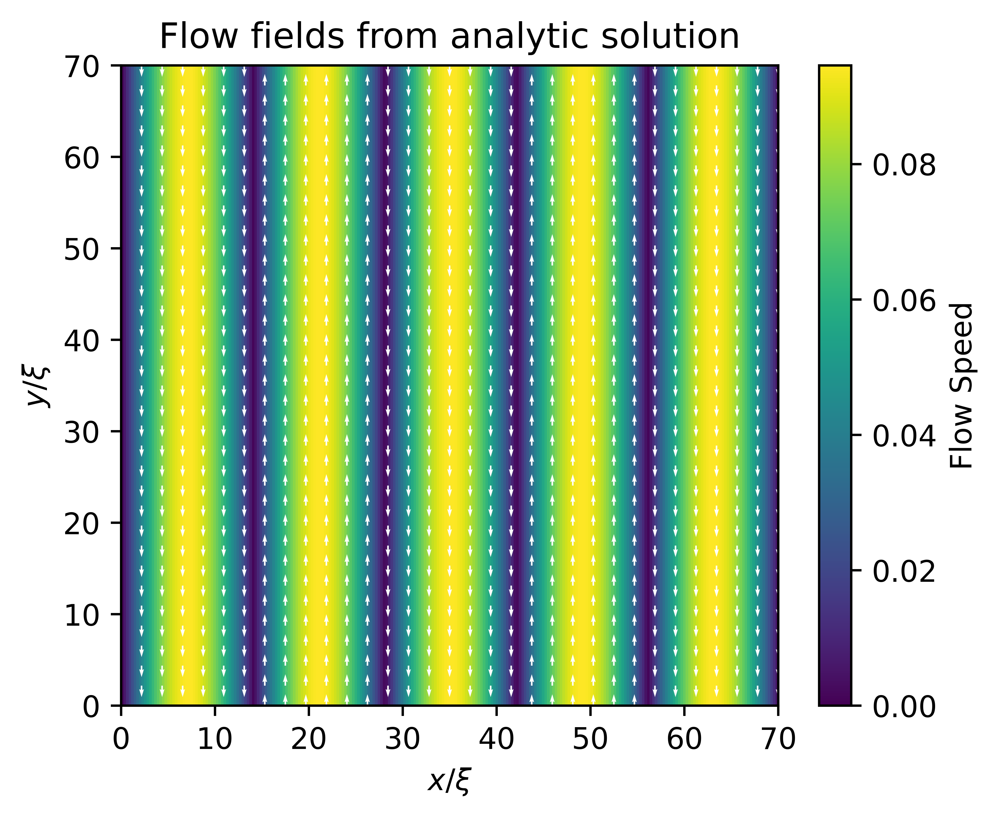

In [83]:
vx = 0*X
vy = analyticVelocity(X, k_x, S, epsilon)
v = np.sqrt(vx**2 + vy**2)

title = 'Flow fields from analytic solution'
filename_analytic_flow =  os.path.join(save_folder, r'flow-field-analytic-10-periods.png')

fig, ax, c, q = plotFlowField(X, Y, vx, vy, v, 
                              title, filename_analytic_flow)

In [84]:
np.max(v)

0.09456760127068213

## Plot source term for various sizes at the given wave-number

In [85]:
lx = 70
ly = 70
nx = 257
ny = 257

X, Y, dx, dy = setUpDomain(lx, ly, nx, ny)
Q = setQConfig(X, Y, lx, ly, nx, ny)
eta, mu, nu = lch.auxVars(Q)

source_term = bhSourceTerm(eta, mu, nu, dx, dy)

In [88]:
def plotSourceTerm(X, Y, source_term, title, filename):
    
    sparse_idx = lch.sparseIdx(source_term.shape, (30, 30))

    fig, ax = plt.subplots(figsize=(5, 4))
    c = ax.pcolor(X, Y, source_term)
    fig.colorbar(c, ax=ax, label="Source Term Magnitude")
    ax.set_title(title)
    ax.set_xlabel(r'$x/\xi$')
    ax.set_ylabel(r'$y/\xi$')

    fig.savefig(filename)
    
    return fig, ax, c

(<Figure size 3500x2800 with 2 Axes>,
 <matplotlib.collections.PolyCollection at 0x22701030248>)

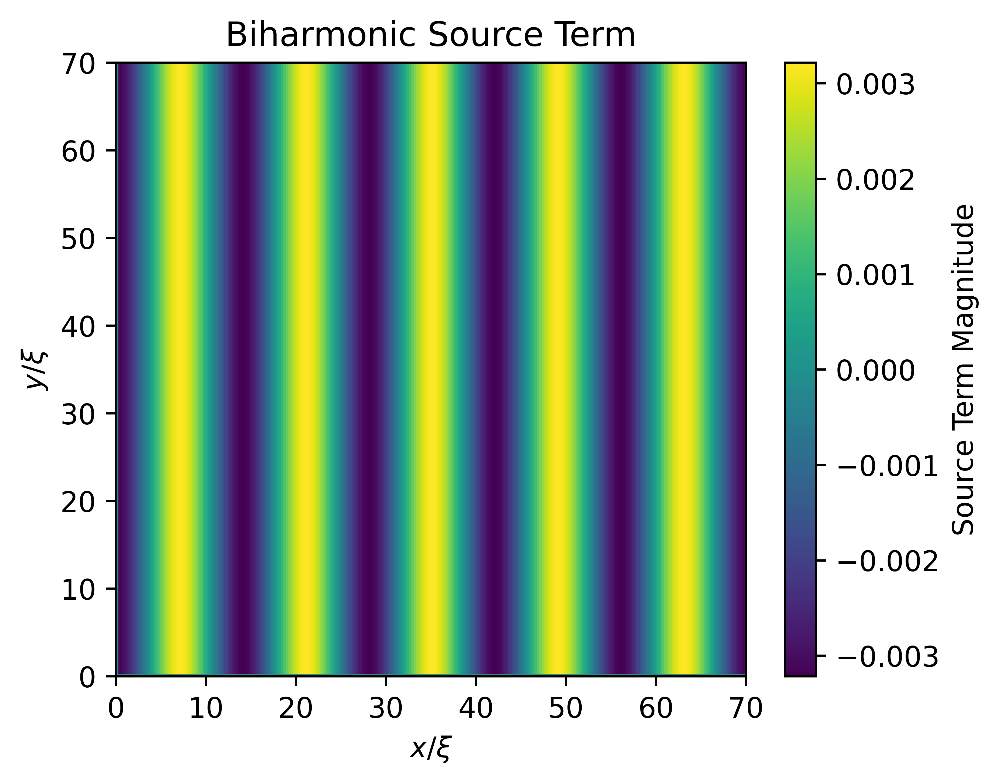

In [90]:
title = "Biharmonic Source Term"
filename_source_term = os.path.join(save_folder, "source-term-magnitude.png")

plotSourceTerm(X, Y, source_term, title, filename_source_term)

In [91]:
np.max(source_term)

0.0032168053103030026

In [95]:
lx = 70
ly_std = 70
nx = 257
ny_std = 257

n = 10

max_source_val = np.zeros(n)
length_array = np.zeros(n)

for i in range(n):
    
    ly = (i + 1)*ly_std
    ny = (i + 1)*ny_std

    X, Y, dx, dy = setUpDomain(lx, ly, nx, ny)
    Q = setQConfig(X, Y, lx, ly, nx, ny)
    eta, mu, nu = lch.auxVars(Q)
    source_term = bhSourceTerm(eta, mu, nu, dx, dy)
    
    max_source_val[i] = np.max(source_term)
    length_array[i] = ly

Text(0, 0.5, 'source-term magnitude')

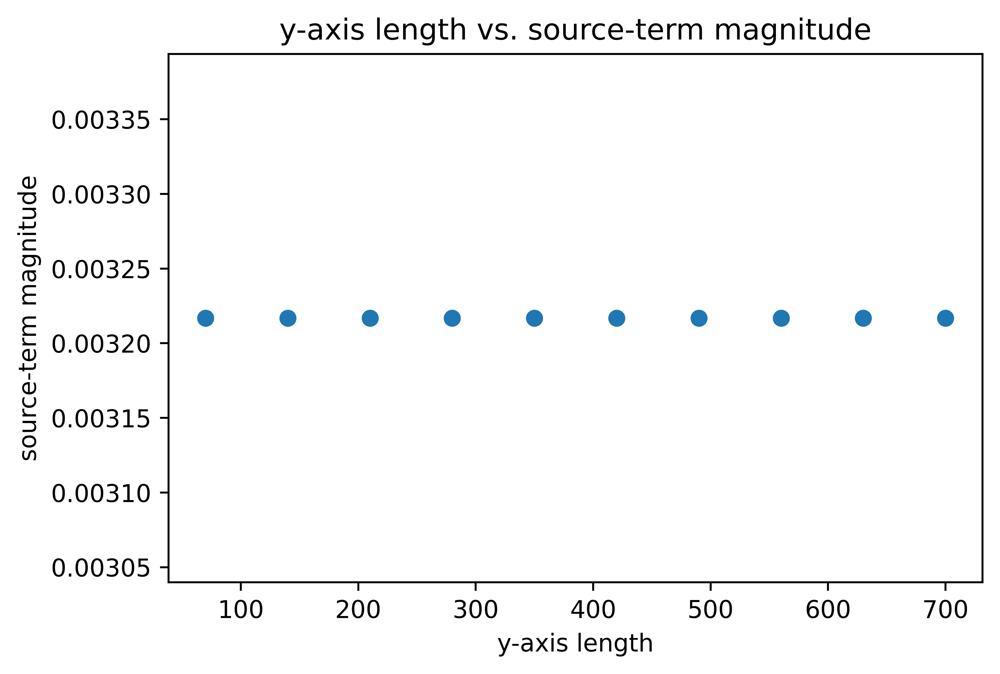

In [98]:
plt.plot(length_array, max_source_val, marker='o', ls='')
plt.title("y-axis length vs. source-term magnitude")
plt.xlabel("y-axis length")
plt.ylabel("source-term magnitude")

## Check numerical solution magnitude as a function of length

In [102]:
lx = 70
ly_std = 70
nx = 257
ny_std = 257

n = 1

max_flow_val = np.zeros(n)
length_array = np.zeros(n)

for i in range(n):
    
    ly = (i + 1)*ly_std
    ny = (i + 1)*ny_std

    X, Y, dx, dy = setUpDomain(lx, ly, nx, ny)
    Q = setQConfig(X, Y, lx, ly, nx, ny)
    eta, mu, nu = lch.auxVars(Q)
    
    source_term = bhSourceTerm(eta, mu, nu, dx, dy)
    bh_solver = setUpBHSolver(lx, ly, nx, ny)
    psi = np.zeros(eta.shape)
    psi[1:-1, 1:-1], info, calls = bh_solver.solve(source_term[1:-1, 1:-1])
    vx, vy = fd.curl(psi, dx, dy)
    v = np.sqrt(vx**2 + vy**2)
    
    max_flow_val[i] = np.max(v)
    length_array[i] = ly

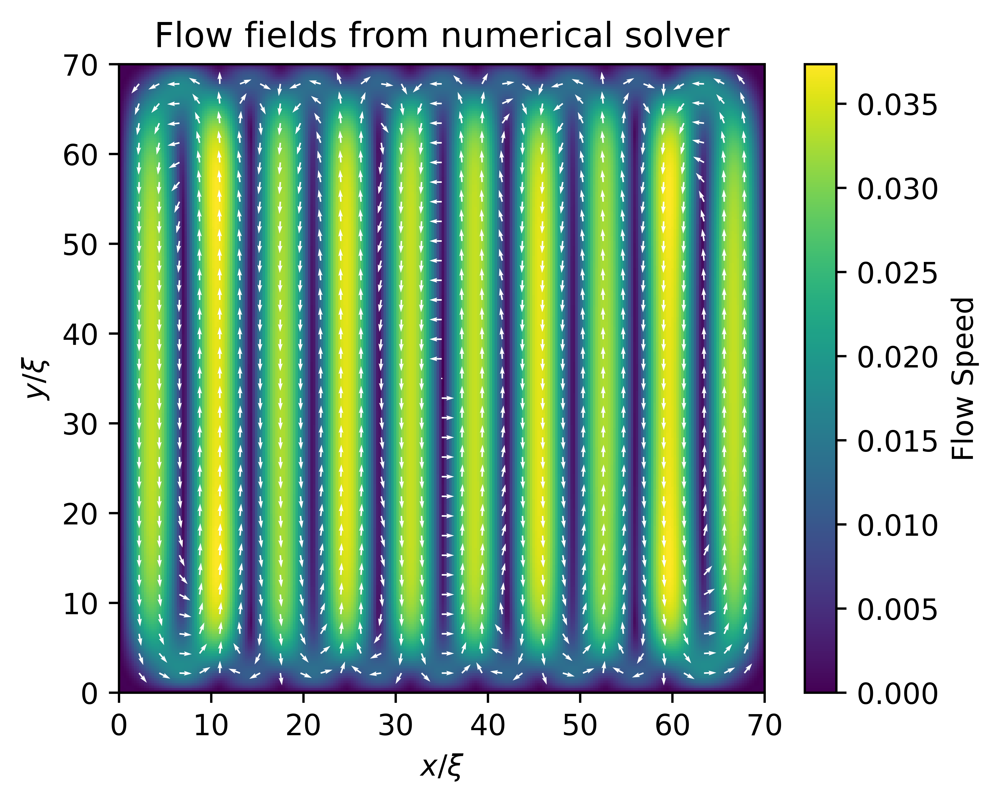

In [100]:
title = 'Flow fields from numerical solver'
filename_numeric_flow = filename_stress_tensor = os.path.join(save_folder, r'flow-field-numerical-square-domain.png')
fig, ax, c, q = plotFlowField(X, Y, vx, vy, v, 
                              title, filename_numeric_flow)

In [106]:
lx = 70
ly_std = 70
nx = 257
ny_std = 257

n = 10

max_flow_val = np.zeros(n)
length_array = np.zeros(n)

for i in range(n):
    
    ly = (i + 1)*ly_std
    ny = (i + 1)*ny_std

    X, Y, dx, dy = setUpDomain(lx, ly, nx, ny)
    Q = setQConfig(X, Y, lx, ly, nx, ny)
    eta, mu, nu = lch.auxVars(Q)
    
    source_term = bhSourceTerm(eta, mu, nu, dx, dy)
    bh_solver = setUpBHSolver(lx, ly, nx, ny)
    psi = np.zeros(eta.shape)
    psi[1:-1, 1:-1], info, calls = bh_solver.solve(source_term[1:-1, 1:-1])
    vx, vy = fd.curl(psi, dx, dy)
    v = np.sqrt(vx**2 + vy**2)
    
    max_flow_val[i] = np.max(v)
    length_array[i] = ly

(0.0, 0.04)

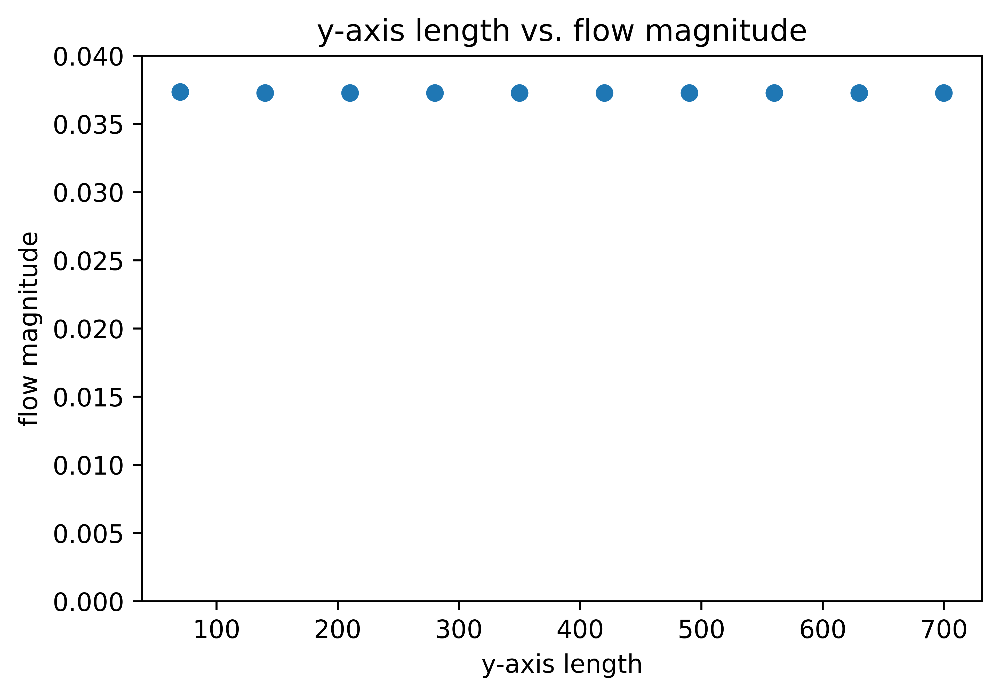

In [109]:
plt.plot(length_array, max_flow_val, marker='o', ls='')
plt.title("y-axis length vs. flow magnitude")
plt.xlabel("y-axis length")
plt.ylabel("flow magnitude")
plt.ylim([0, 0.04])

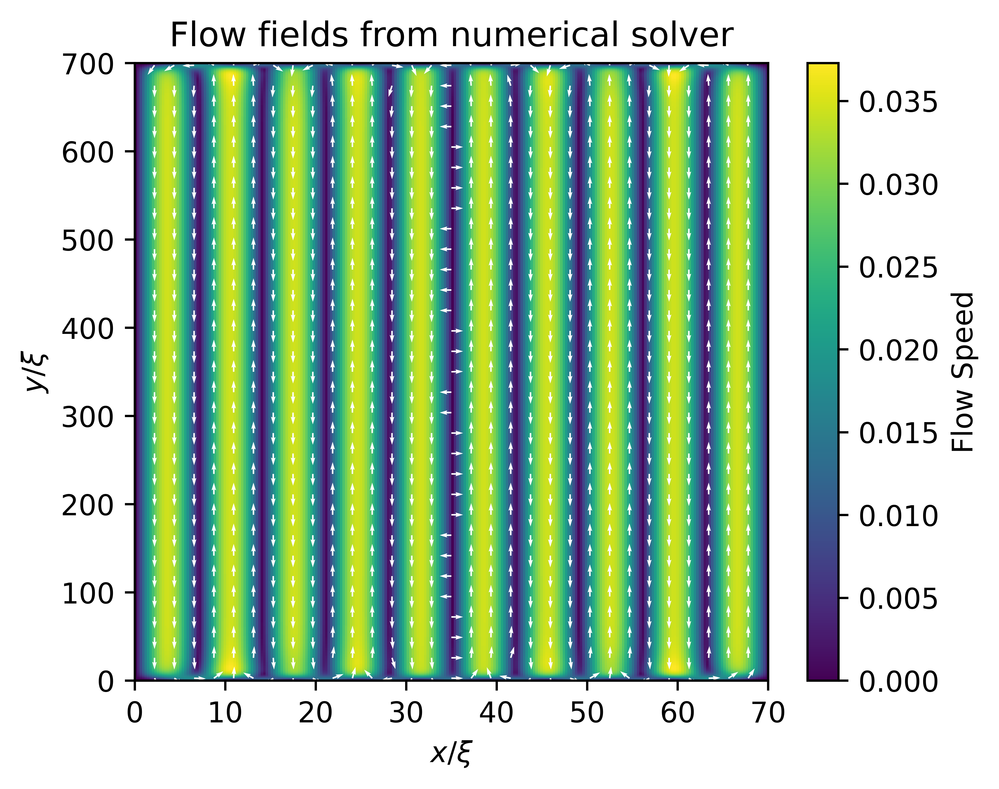

In [110]:
title = 'Flow fields from numerical solver'
filename_numeric_flow = filename_stress_tensor = os.path.join(save_folder, r'flow-field-numerical-long-domain.png')
fig, ax, c, q = plotFlowField(X, Y, vx, vy, v, 
                              title, filename_numeric_flow)

## Check numerical solution as a function of y-grid-spacing

In [111]:
lx = 70
ly = 70
nx = 257
ny_std = 257

n = 10

max_flow_val = np.zeros(n)
spacing_array = np.zeros(n)

for i in range(n):
    
    ny = (i + 1)*ny_std

    X, Y, dx, dy = setUpDomain(lx, ly, nx, ny)
    Q = setQConfig(X, Y, lx, ly, nx, ny)
    eta, mu, nu = lch.auxVars(Q)
    
    source_term = bhSourceTerm(eta, mu, nu, dx, dy)
    bh_solver = setUpBHSolver(lx, ly, nx, ny)
    psi = np.zeros(eta.shape)
    psi[1:-1, 1:-1], info, calls = bh_solver.solve(source_term[1:-1, 1:-1])
    vx, vy = fd.curl(psi, dx, dy)
    v = np.sqrt(vx**2 + vy**2)
    
    max_flow_val[i] = np.max(v)
    spacing_array[i] = ly/ny

(0.0, 0.05)

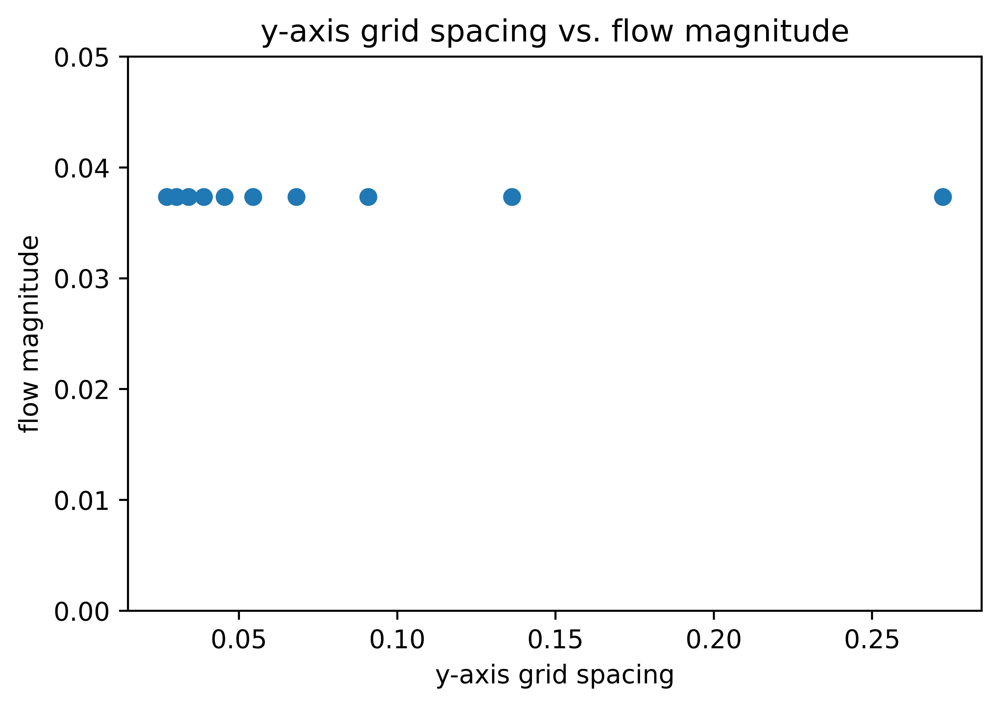

In [114]:
plt.plot(spacing_array, max_flow_val, marker='o', ls='')
plt.title("y-axis grid spacing vs. flow magnitude")
plt.xlabel("y-axis grid spacing")
plt.ylabel("flow magnitude")
plt.ylim([0, 0.05])

## Check it as a function of length (without changing number of gridpoints)

In [115]:
lx = 70
ly_std = 70
nx = 257
ny = 257

n = 10

max_flow_val = np.zeros(n)
length_array = np.zeros(n)

for i in range(n):
    
    ly = (i + 1)*ly_std

    X, Y, dx, dy = setUpDomain(lx, ly, nx, ny)
    Q = setQConfig(X, Y, lx, ly, nx, ny)
    eta, mu, nu = lch.auxVars(Q)
    
    source_term = bhSourceTerm(eta, mu, nu, dx, dy)
    bh_solver = setUpBHSolver(lx, ly, nx, ny)
    psi = np.zeros(eta.shape)
    psi[1:-1, 1:-1], info, calls = bh_solver.solve(source_term[1:-1, 1:-1])
    vx, vy = fd.curl(psi, dx, dy)
    v = np.sqrt(vx**2 + vy**2)
    
    max_flow_val[i] = np.max(v)
    length_array[i] = ly

(0.0, 0.04)

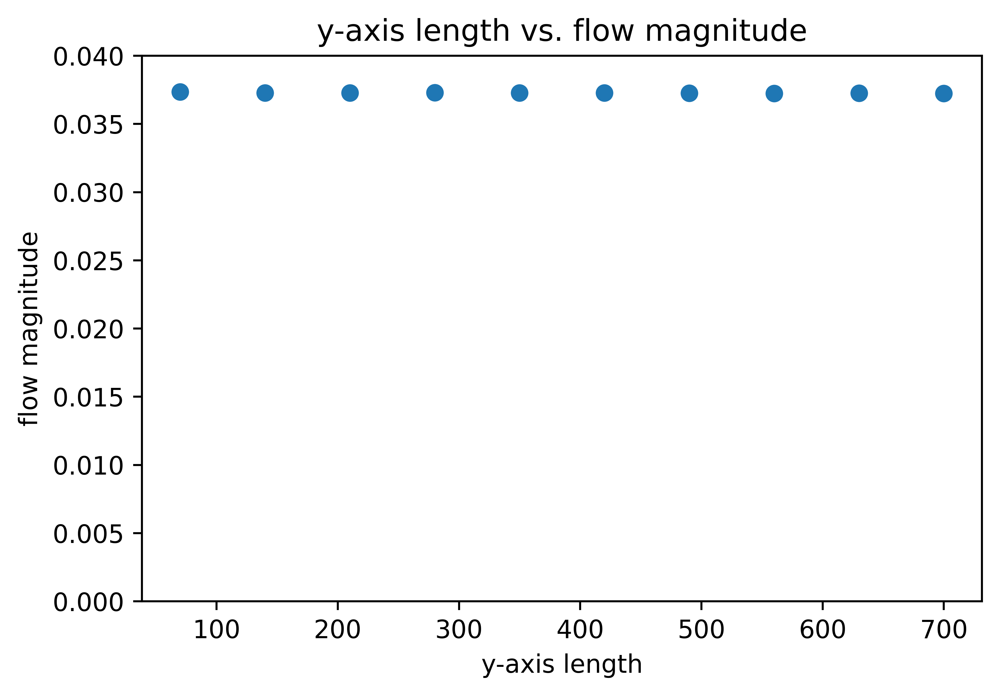

In [116]:
plt.plot(length_array, max_flow_val, marker='o', ls='')
plt.title("y-axis length vs. flow magnitude")
plt.xlabel("y-axis length")
plt.ylabel("flow magnitude")
plt.ylim([0, 0.04])

## Now let's try the x-length

In [117]:
lx_std = 70
ly = 70
nx_std = 257
ny = 257

n = 10

max_flow_val = np.zeros(n)
length_array = np.zeros(n)

for i in range(n):
    
    lx = (i + 1)*lx_std
    nx = (i + 1)*nx_std

    X, Y, dx, dy = setUpDomain(lx, ly, nx, ny)
    Q = setQConfig(X, Y, lx, ly, nx, ny)
    eta, mu, nu = lch.auxVars(Q)
    
    source_term = bhSourceTerm(eta, mu, nu, dx, dy)
    bh_solver = setUpBHSolver(lx, ly, nx, ny)
    psi = np.zeros(eta.shape)
    psi[1:-1, 1:-1], info, calls = bh_solver.solve(source_term[1:-1, 1:-1])
    vx, vy = fd.curl(psi, dx, dy)
    v = np.sqrt(vx**2 + vy**2)
    
    max_flow_val[i] = np.max(v)
    length_array[i] = lx

(0.0, 0.05)

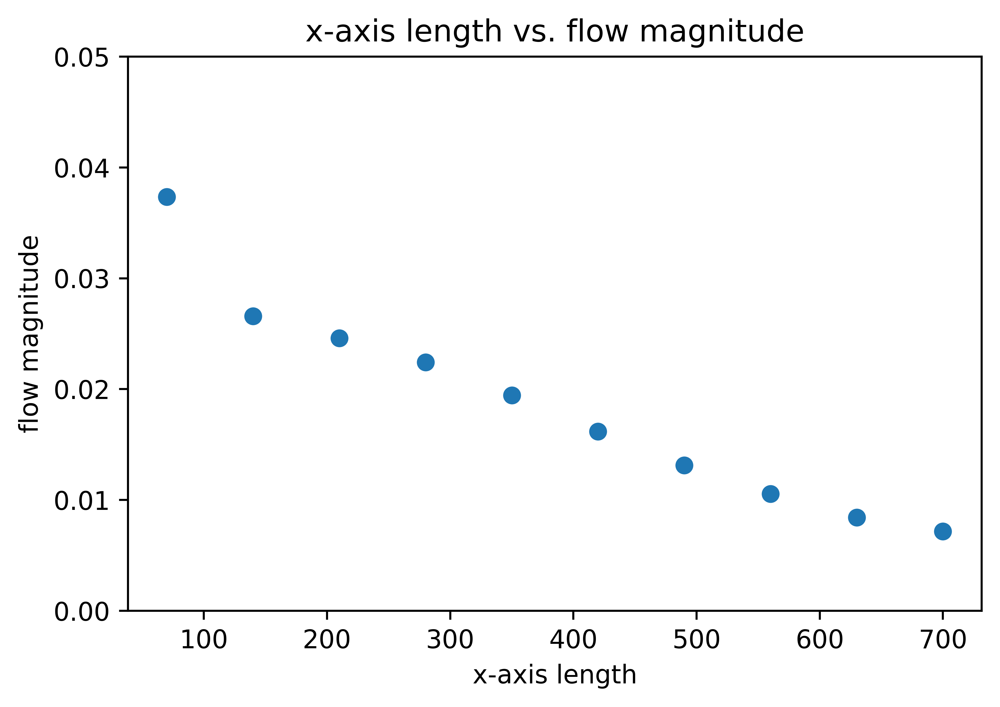

In [119]:
plt.plot(length_array, max_flow_val, marker='o', ls='')
plt.title("x-axis length vs. flow magnitude")
plt.xlabel("x-axis length")
plt.ylabel("flow magnitude")
plt.ylim([0, 0.05])

## See how the source term does with this

In [131]:
lx_std = 70
ly = 70
nx_std = 257
ny = 257
n_periods_std = 10

n = 10

max_source_term_val = np.zeros(n)
length_array = np.zeros(n)

for i in range(n):
    
    lx = (i + 1)*lx_std
    nx = (i + 1)*nx_std
    

    X, Y, dx, dy = setUpDomain(lx, ly, nx, ny)
    Q = setQConfig(X, Y, lx, ly, nx, ny, n_periods=(i + 1)*n_periods)
    eta, mu, nu = lch.auxVars(Q)
    
    source_term = bhSourceTerm(eta, mu, nu, dx, dy)
    
    max_source_term_val[i] = np.max(source_term)
    length_array[i] = lx

(0.0, 0.004)

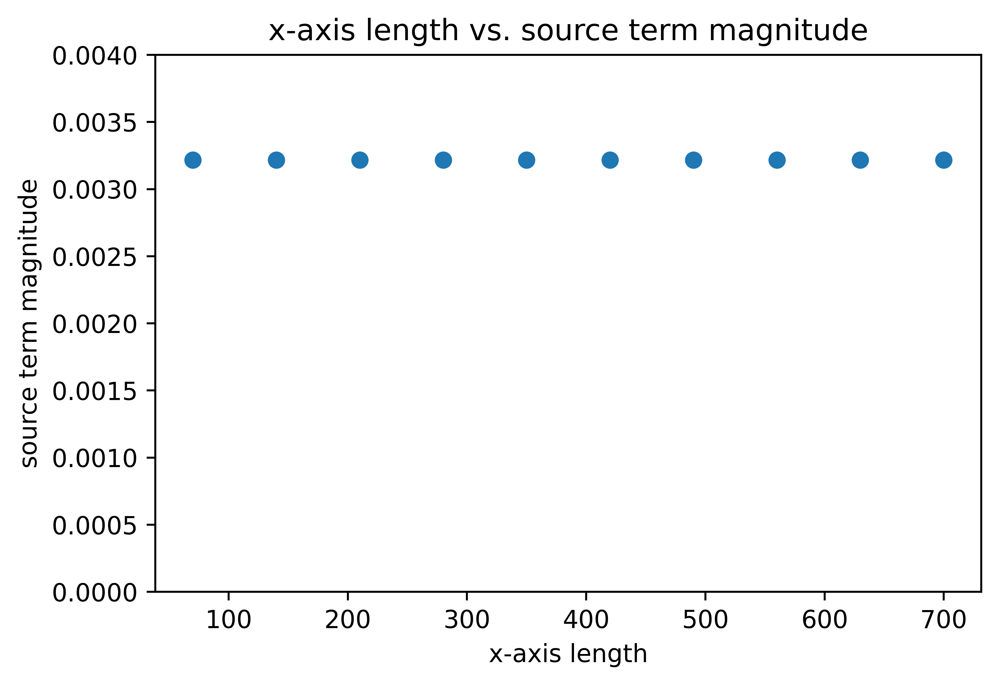

In [135]:
plt.plot(length_array, max_source_term_val, marker='o', ls='')
plt.title("x-axis length vs. source term magnitude")
plt.xlabel("x-axis length")
plt.ylabel("source term magnitude")
plt.ylim([0, 4e-3])

# Need to check the dependence on a, b, and wave-number for both

## First check on wavenumber

In [165]:
lx = 70
ly = 70
nx = 257
ny = 257

n_periods_ar_numerical = np.array([1, 2, 3, 5, 10, 15, 20, 30, 40, 50, 
                                   60, 70, 80, 90, 100, 110, 120, 130, 140, 150])
max_flow_val_numerical = np.zeros(np.shape(n_periods_ar_numerical))

i = 0
for n_periods in n_periods_ar_numerical:

    X, Y, dx, dy = setUpDomain(lx, ly, nx, ny)
    Q = setQConfig(X, Y, lx, ly, nx, ny, n_periods=n_periods)
    eta, mu, nu = lch.auxVars(Q)
    
    source_term = bhSourceTerm(eta, mu, nu, dx, dy)
    bh_solver = setUpBHSolver(lx, ly, nx, ny)
    psi = np.zeros(eta.shape)
    psi[1:-1, 1:-1], info, calls = bh_solver.solve(source_term[1:-1, 1:-1])
    vx, vy = fd.curl(psi, dx, dy)
    v = np.sqrt(vx**2 + vy**2)
    
    max_flow_val_numerical[i] = np.max(v)
    i += 1

Text(0, 0.5, 'flow magnitude')

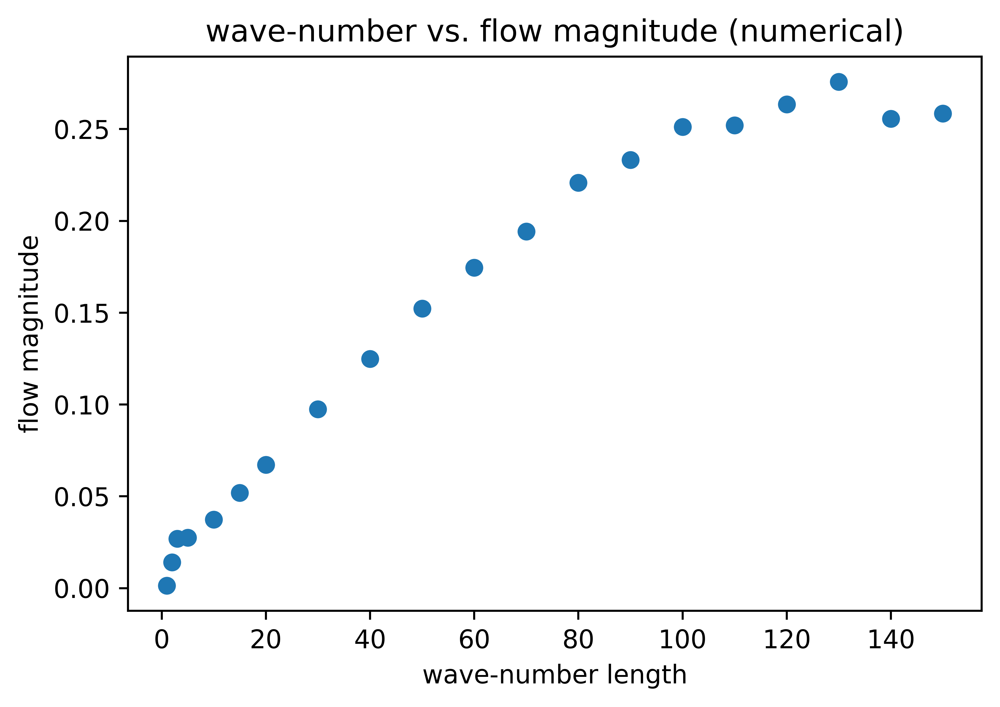

In [166]:
plt.plot(n_periods_ar_numerical, max_flow_val_numerical, marker='o', ls='')
plt.title("wave-number vs. flow magnitude (numerical)")
plt.xlabel("wave-number length")
plt.ylabel("flow magnitude")

In [167]:
lx = 70
S = 0.5
epsilon = 0.1

n_periods_ar_analytic = np.linspace(1, 150, num=1000)
max_flow_val_analytic = np.zeros(np.shape(n_periods_ar))

i = 0
for n_periods in n_periods_ar_analytic:

    k_x = n_periods*np.pi/lx
    max_flow_val_analytic[i] = analyticVelocityCoeff(k_x, S, epsilon, a=lch.a, b=lch.b)
    i += 1

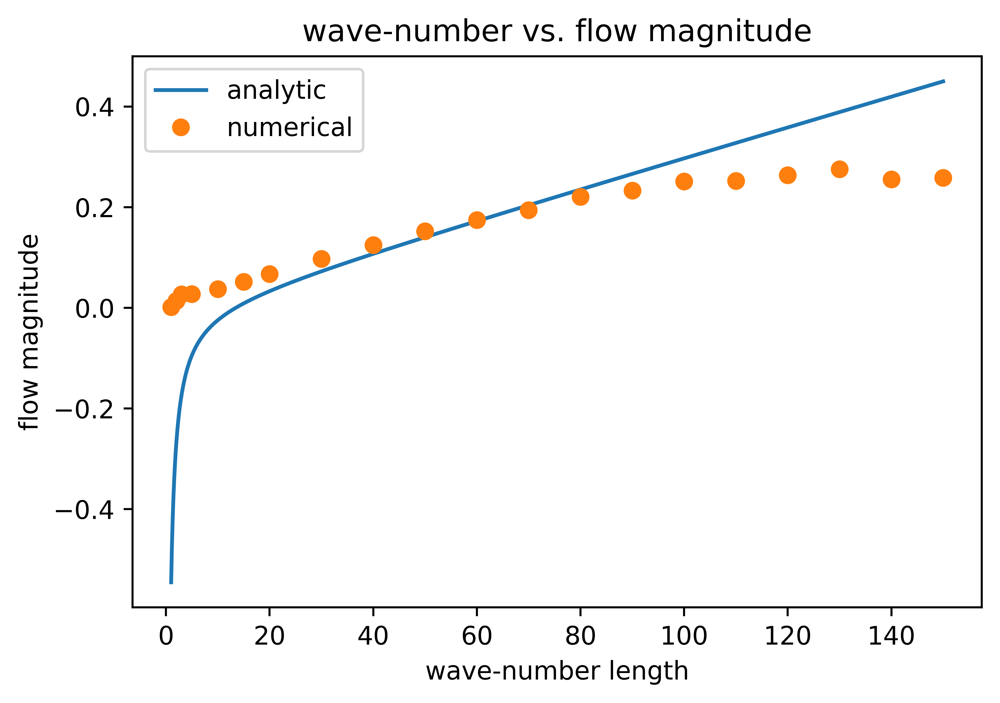

In [168]:
plt.plot(n_periods_ar_analytic, max_flow_val_analytic, label="analytic")
plt.plot(n_periods_ar_numerical, max_flow_val_numerical, marker='o', ls='', label="numerical")
plt.title("wave-number vs. flow magnitude")
plt.xlabel("wave-number length")
plt.ylabel("flow magnitude")
plt.legend()

## Check on a-dependence

In [169]:
lch.a

-1.92

In [217]:
lx = 70
ly = 70
nx = 257
ny = 257

a_array_numerical = np.linspace(-10, 10, num=100)
max_flow_val_numerical = np.zeros(np.shape(a_array_numerical))

i = 0
for a in a_array_numerical:

    X, Y, dx, dy = setUpDomain(lx, ly, nx, ny)
    Q = setQConfig(X, Y, lx, ly, nx, ny, n_periods=n_periods)
    eta, mu, nu = lch.auxVars(Q)
    
    source_term = bhSourceTerm(eta, mu, nu, dx, dy, a=a)
    bh_solver = setUpBHSolver(lx, ly, nx, ny)
    psi = np.zeros(eta.shape)
    psi[1:-1, 1:-1], info, calls = bh_solver.solve(source_term[1:-1, 1:-1])
    vx, vy = fd.curl(psi, dx, dy)
    v = np.sqrt(vx**2 + vy**2)
    
    max_arg = np.unravel_index(np.argmax(np.abs(vy)), vy.shape)
    
    max_flow_val_numerical[i] = vy[max_arg]
    i += 1

Text(0, 0.5, 'flow velocity')

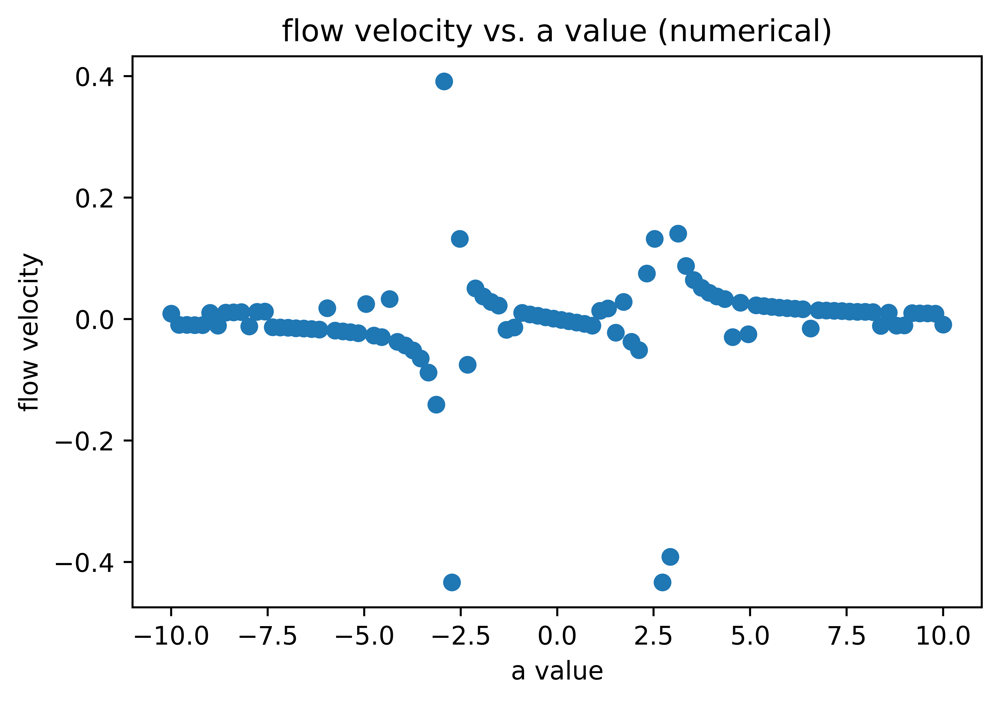

In [218]:
plt.plot(a_array_numerical, max_flow_val_numerical, marker='o', ls='')
plt.title("flow velocity vs. a value (numerical)")
plt.xlabel("a value")
plt.ylabel("flow velocity")

In [219]:
lx = 70
S = 0.5
epsilon = 0.1
n_periods = 10

a_array_analytic = np.linspace(-10, 10, num=1000)
max_flow_val_analytic = np.zeros(np.shape(a_array_analytic))

i = 0
for a in a_array_analytic:

    k_x = n_periods*np.pi/lx
    max_flow_val_analytic[i] = analyticVelocityCoeff(k_x, S, epsilon, a=a)
    i += 1

(-0.5, 0.5)

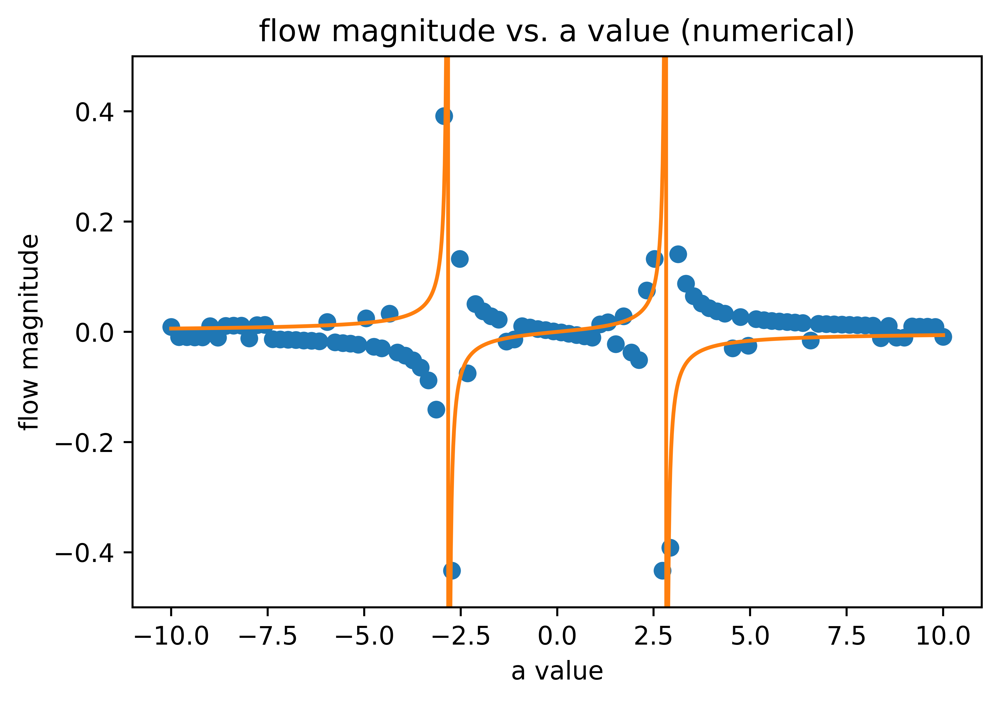

In [220]:
plt.plot(a_array_numerical, max_flow_val_numerical, marker='o', ls='')
plt.plot(a_array_analytic, max_flow_val_analytic)
plt.title("flow magnitude vs. a value (numerical)")
plt.xlabel("a value")
plt.ylabel("flow magnitude")
plt.ylim([-0.5, 0.5])

### Same thing for b

In [201]:
lch.b

1.99

In [222]:
lx = 70
ly = 70
nx = 257
ny = 257

b_array_numerical = np.linspace(-10, 10, num=200)
max_flow_val_numerical = np.zeros(np.shape(b_array_numerical))

i = 0
for b in b_array_numerical:

    X, Y, dx, dy = setUpDomain(lx, ly, nx, ny)
    Q = setQConfig(X, Y, lx, ly, nx, ny, n_periods=n_periods)
    eta, mu, nu = lch.auxVars(Q)
    
    source_term = bhSourceTerm(eta, mu, nu, dx, dy, b=b)
    bh_solver = setUpBHSolver(lx, ly, nx, ny)
    psi = np.zeros(eta.shape)
    psi[1:-1, 1:-1], info, calls = bh_solver.solve(source_term[1:-1, 1:-1])
    vx, vy = fd.curl(psi, dx, dy)
    v = np.sqrt(vx**2 + vy**2)
    
    max_arg = np.unravel_index(np.argmax(np.abs(vy)), vy.shape)
    
    max_flow_val_numerical[i] = vy[max_arg]
    i += 1

Text(0, 0.5, 'flow velocity')

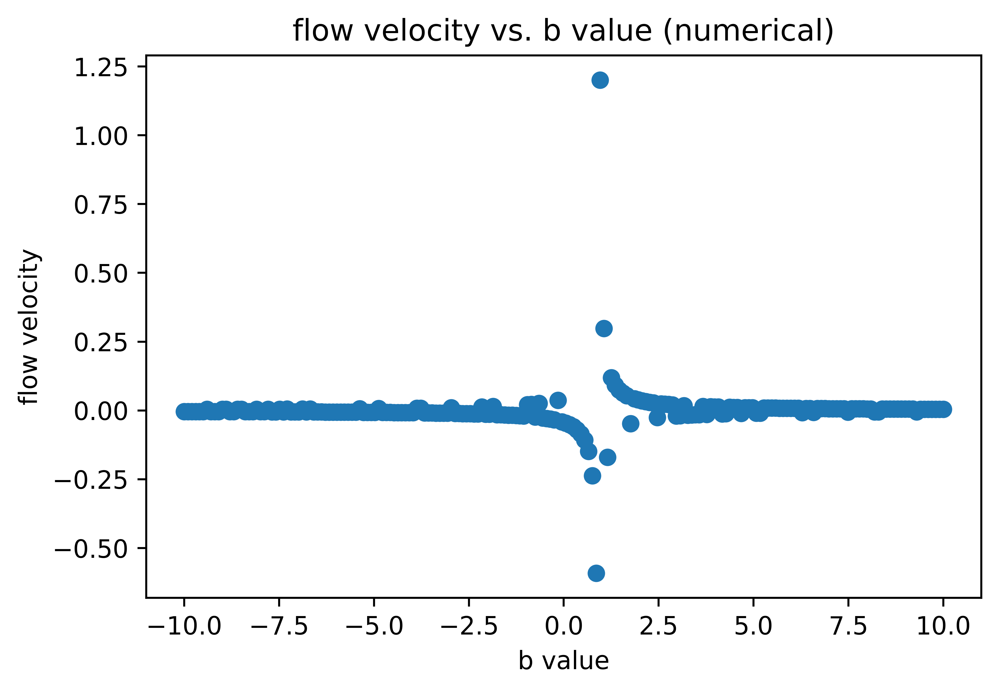

In [223]:
plt.plot(b_array_numerical, max_flow_val_numerical, marker='o', ls='')
plt.title("flow velocity vs. b value (numerical)")
plt.xlabel("b value")
plt.ylabel("flow velocity")

In [224]:
lx = 70
S = 0.5
epsilon = 0.1
n_periods = 10

b_array_analytic = np.linspace(-10, 10, num=1000)
max_flow_val_analytic = np.zeros(np.shape(b_array_analytic))

i = 0
for b in b_array_analytic:

    k_x = n_periods*np.pi/lx
    max_flow_val_analytic[i] = analyticVelocityCoeff(k_x, S, epsilon, b=b)
    i += 1

(-0.5, 0.5)

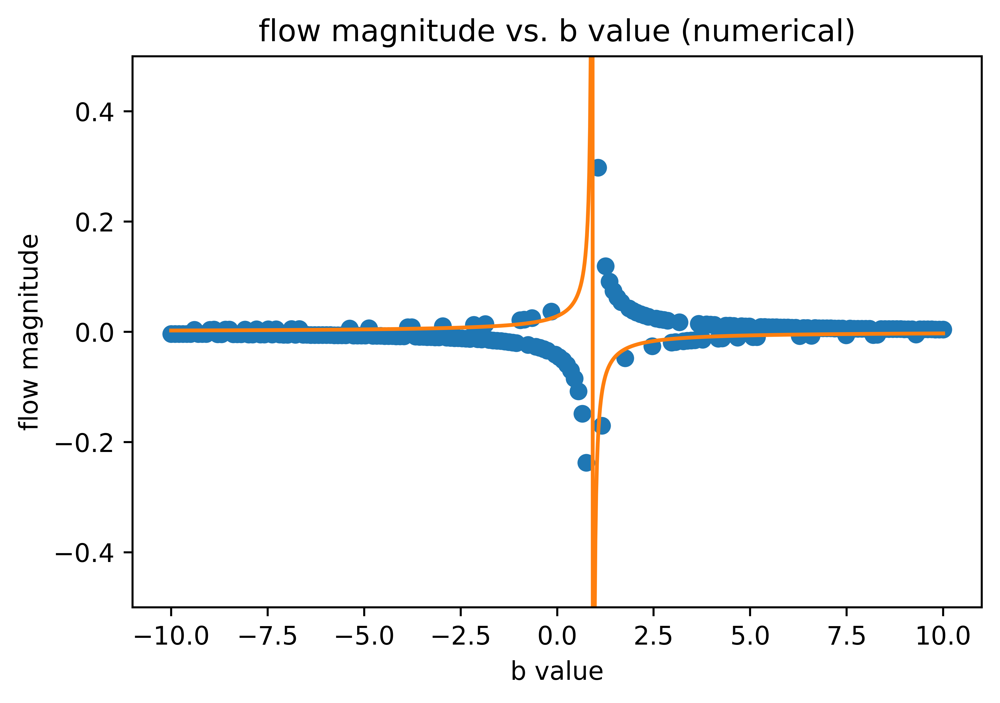

In [225]:
plt.plot(b_array_numerical, max_flow_val_numerical, marker='o', ls='')
plt.plot(b_array_analytic, max_flow_val_analytic)
plt.title("flow magnitude vs. b value (numerical)")
plt.xlabel("b value")
plt.ylabel("flow magnitude")
plt.ylim([-0.5, 0.5])

# Now for 20 periods

In [257]:
epsilon = 0.1
S = 0.5
n_hat = np.zeros((3,) + np.shape(X))

k_x = 20*np.pi/(2*l)

n_hat[0] = epsilon*np.cos(k_x*X)
n_hat[1] = 1

Q = np.zeros((3, 3) + np.shape(X))
I = np.eye(n, n)

for i in range(3):
    for j in range(3):
        Q[i, j] = (S/2)*(3*n_hat[i]*n_hat[j] - I[i, j])

In [258]:
eta, mu, nu = lch.auxVars(Q)

In [259]:
psi = np.zeros(eta.shape)
source_term = (1 / (lch.b - (1/4)*lch.a**2)) * ( 2*lch.f1(eta, mu, nu, dx) + (1/2)*lch.a*lch.f2(eta, mu, nu, dx) )
psi[1:-1, 1:-1], info, calls = bh_solver.solve(source_term[1:-1, 1:-1])

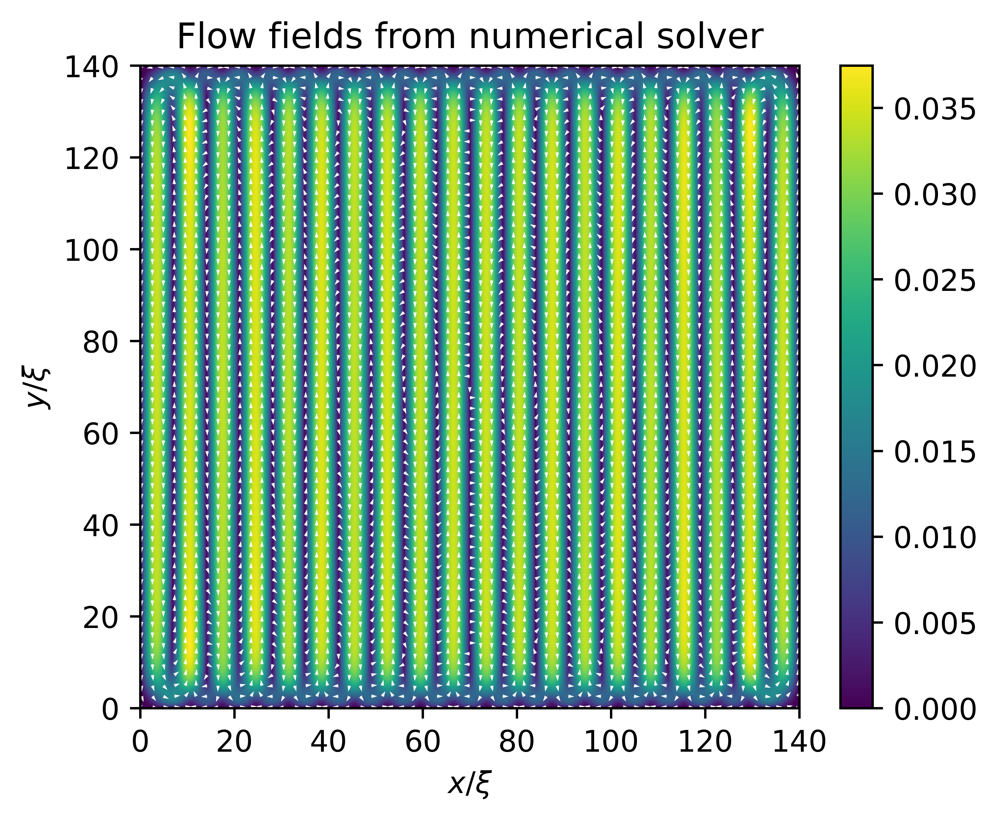

In [260]:
vx, vy = fd.curl(psi, dx)
v = np.sqrt(vx**2 + vy**2)

mask = np.where(v != 0)
vx_norm = np.zeros(vx.shape)
vy_norm = np.zeros(vy.shape)
vx_norm[mask] = vx[mask]/v[mask]
vy_norm[mask] = vy[mask]/v[mask]

sparse_idx = lch.sparseIdx(vx.shape, (60, 60))

fig, ax = plt.subplots(figsize=(5, 4))
c = ax.pcolor(X, Y, v)
fig.colorbar(c, ax=ax)
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              vx_norm[sparse_idx], vy_norm[sparse_idx], pivot='tail', color='w')
ax.set_title('Flow fields from numerical solver')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')

filename_stress_tensor = os.path.join(save_folder, r'flow-field-numerical-20-periods.png')
fig.savefig(filename_stress_tensor)

In [261]:
alpha = 1/(lch.b - (1/4)*lch.a**2)
def analyticVelocity(x):
    return -3*alpha*lch.a*S/(4*k_x) * (lch.A + S*lch.B + 3*S**2/2 * lch.C + k_x**2) * epsilon * np.sin(k_x*x)

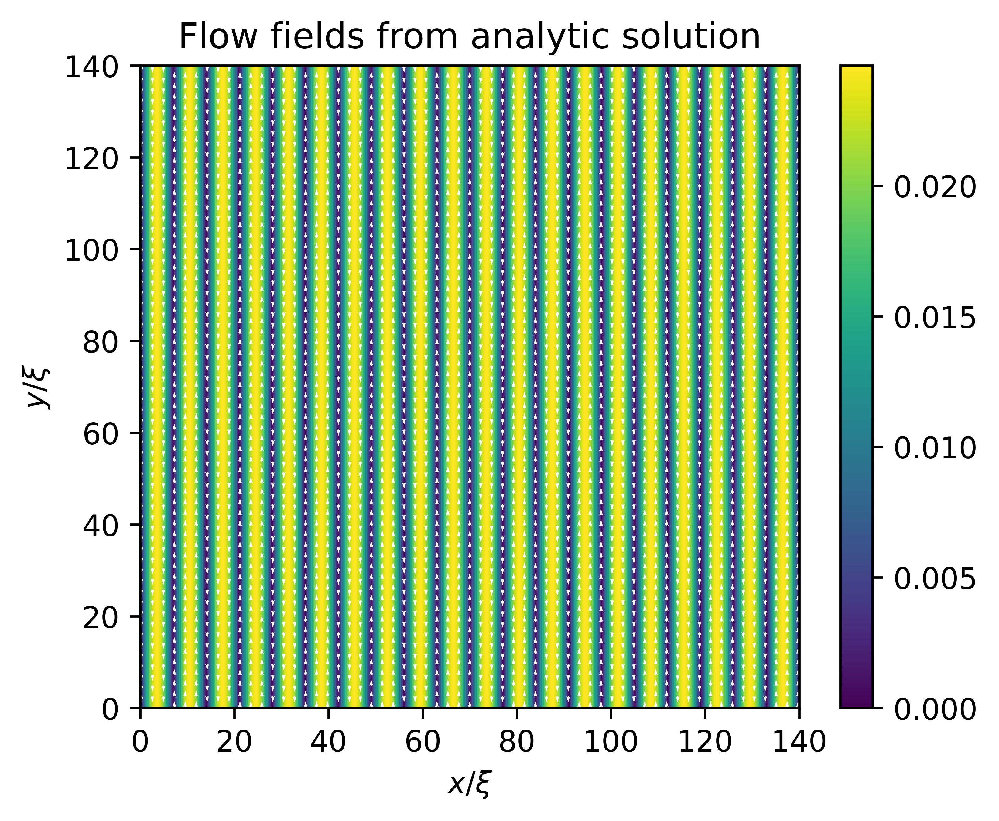

In [262]:
vx = 0*X
vy = analyticVelocity(X)
v = np.sqrt(vx**2 + vy**2)

mask = np.where(v != 0)
vx_norm = np.zeros(vx.shape)
vy_norm = np.zeros(vy.shape)
vx_norm[mask] = vx[mask]/v[mask]
vy_norm[mask] = vy[mask]/v[mask]

sparse_idx = lch.sparseIdx(vx.shape, (60, 60))

fig, ax = plt.subplots(figsize=(5, 4))
c = ax.pcolor(X, Y, v)
fig.colorbar(c, ax=ax)
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              vx_norm[sparse_idx], vy_norm[sparse_idx], pivot='tail', color='w')
ax.set_title('Flow fields from analytic solution')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')

filename_stress_tensor = os.path.join(save_folder, r'flow-field-analytic-20-periods.png')
fig.savefig(filename_stress_tensor)

# Now for 30 periods

In [263]:
epsilon = 0.1
S = 0.5
n_hat = np.zeros((3,) + np.shape(X))

k_x = 30*np.pi/(2*l)

n_hat[0] = epsilon*np.cos(k_x*X)
n_hat[1] = 1

Q = np.zeros((3, 3) + np.shape(X))
I = np.eye(n, n)

for i in range(3):
    for j in range(3):
        Q[i, j] = (S/2)*(3*n_hat[i]*n_hat[j] - I[i, j])

In [264]:
eta, mu, nu = lch.auxVars(Q)

In [265]:
psi = np.zeros(eta.shape)
source_term = (1 / (lch.b - (1/4)*lch.a**2)) * ( 2*lch.f1(eta, mu, nu, dx) + (1/2)*lch.a*lch.f2(eta, mu, nu, dx) )
psi[1:-1, 1:-1], info, calls = bh_solver.solve(source_term[1:-1, 1:-1])

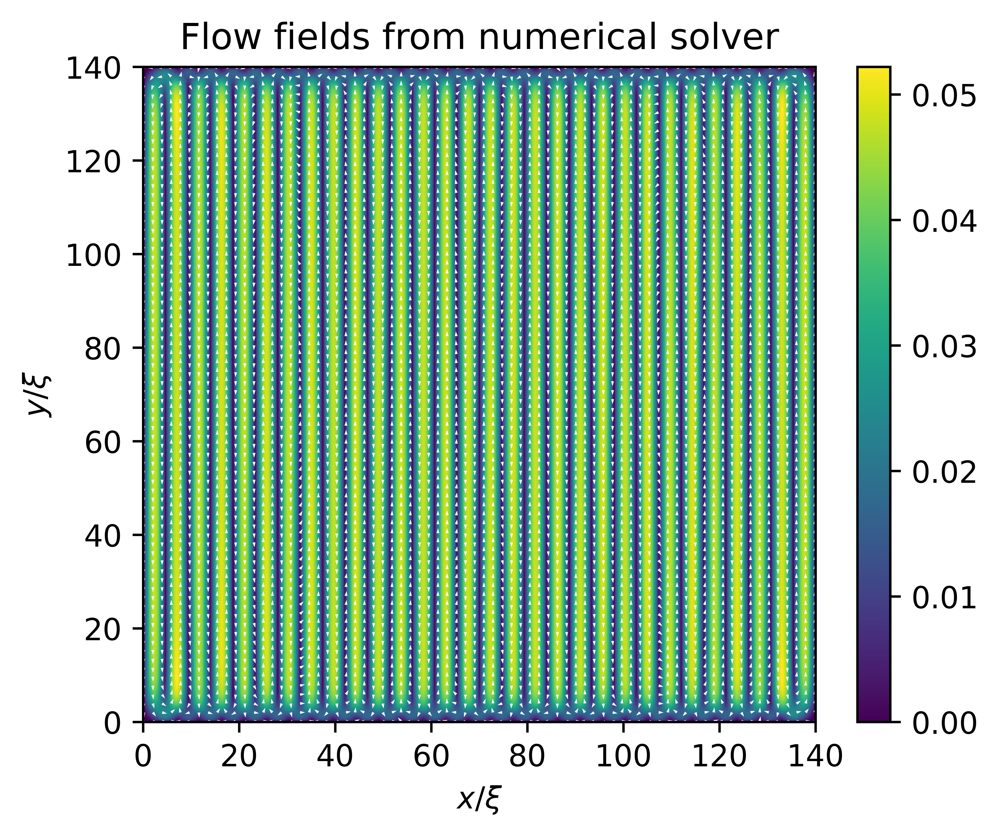

In [269]:
vx, vy = fd.curl(psi, dx)
v = np.sqrt(vx**2 + vy**2)

mask = np.where(v != 0)
vx_norm = np.zeros(vx.shape)
vy_norm = np.zeros(vy.shape)
vx_norm[mask] = vx[mask]/v[mask]
vy_norm[mask] = vy[mask]/v[mask]

sparse_idx = lch.sparseIdx(vx.shape, (70, 70))

fig, ax = plt.subplots(figsize=(5, 4))
c = ax.pcolor(X, Y, v)
fig.colorbar(c, ax=ax)
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              vx_norm[sparse_idx], vy_norm[sparse_idx], pivot='tail', color='w')
ax.set_title('Flow fields from numerical solver')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')

filename_stress_tensor = os.path.join(save_folder, r'flow-field-numerical-30-periods.png')
fig.savefig(filename_stress_tensor)

In [270]:
alpha = 1/(lch.b - (1/4)*lch.a**2)
def analyticVelocity(x):
    return -3*alpha*lch.a*S/(4*k_x) * (lch.A + S*lch.B + 3*S**2/2 * lch.C + k_x**2) * epsilon * np.sin(k_x*x)

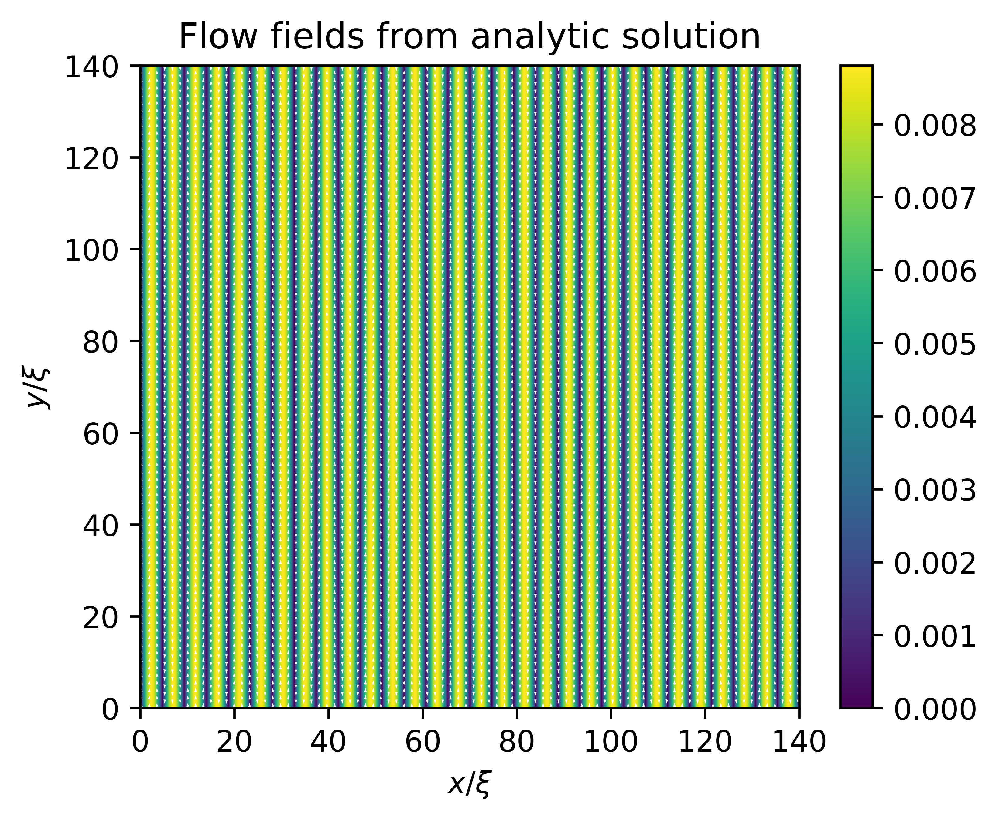

In [272]:
vx = 0*X
vy = analyticVelocity(X)
v = np.sqrt(vx**2 + vy**2)

mask = np.where(v != 0)
vx_norm = np.zeros(vx.shape)
vy_norm = np.zeros(vy.shape)
vx_norm[mask] = vx[mask]/v[mask]
vy_norm[mask] = vy[mask]/v[mask]

sparse_idx = lch.sparseIdx(vx.shape, (80, 80))

fig, ax = plt.subplots(figsize=(5, 4))
c = ax.pcolor(X, Y, v)
fig.colorbar(c, ax=ax)
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              vx_norm[sparse_idx], vy_norm[sparse_idx], pivot='tail', color='w')
ax.set_title('Flow fields from analytic solution')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')

filename_stress_tensor = os.path.join(save_folder, r'flow-field-analytic-30-periods.png')
fig.savefig(filename_stress_tensor)

# More

In [287]:
epsilon = 0.1
S = 0.5
n_hat = np.zeros((3,) + np.shape(X))

k_x = 50*np.pi/(2*l)

n_hat[0] = epsilon*np.cos(k_x*X)
n_hat[1] = 1

Q = np.zeros((3, 3) + np.shape(X))
I = np.eye(n, n)

for i in range(3):
    for j in range(3):
        Q[i, j] = (S/2)*(3*n_hat[i]*n_hat[j] - I[i, j])

In [288]:
eta, mu, nu = lch.auxVars(Q)

In [289]:
psi = np.zeros(eta.shape)
source_term = (1 / (lch.b - (1/4)*lch.a**2)) * ( 2*lch.f1(eta, mu, nu, dx) + (1/2)*lch.a*lch.f2(eta, mu, nu, dx) )
psi[1:-1, 1:-1], info, calls = bh_solver.solve(source_term[1:-1, 1:-1])

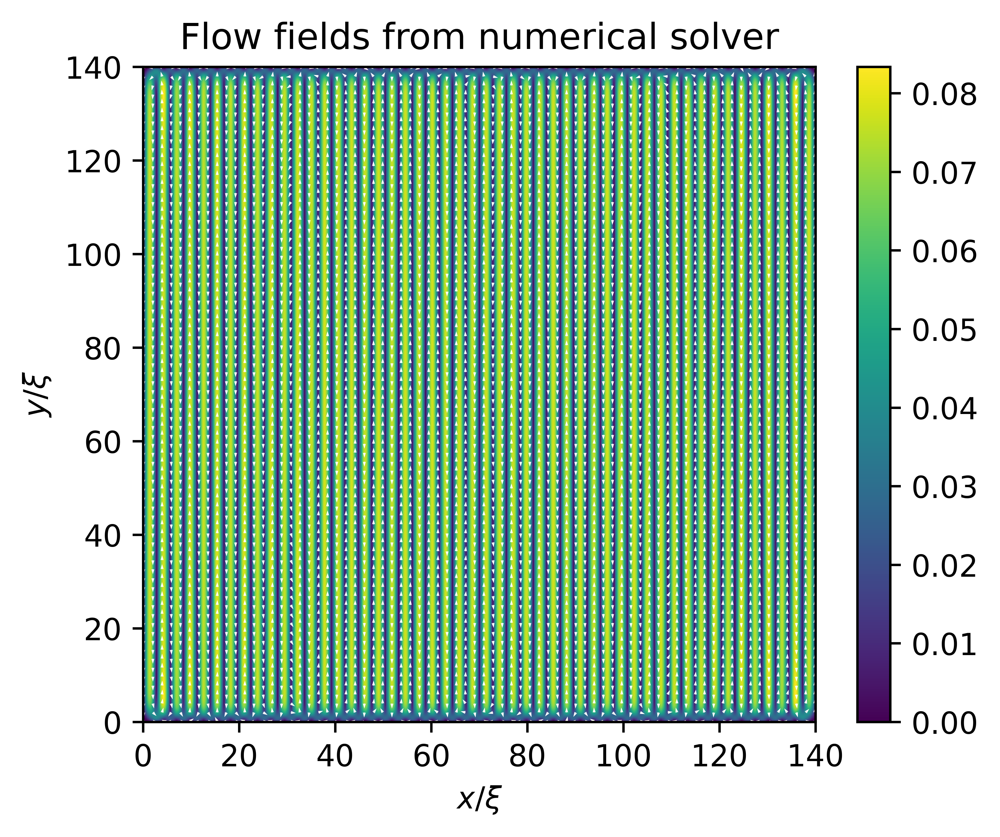

In [290]:
vx, vy = fd.curl(psi, dx)
v = np.sqrt(vx**2 + vy**2)

mask = np.where(v != 0)
vx_norm = np.zeros(vx.shape)
vy_norm = np.zeros(vy.shape)
vx_norm[mask] = vx[mask]/v[mask]
vy_norm[mask] = vy[mask]/v[mask]

sparse_idx = lch.sparseIdx(vx.shape, (70, 70))

fig, ax = plt.subplots(figsize=(5, 4))
c = ax.pcolor(X, Y, v)
fig.colorbar(c, ax=ax)
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              vx_norm[sparse_idx], vy_norm[sparse_idx], pivot='tail', color='w')
ax.set_title('Flow fields from numerical solver')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')

filename_stress_tensor = os.path.join(save_folder, r'flow-field-numerical-50-periods.png')
fig.savefig(filename_stress_tensor)